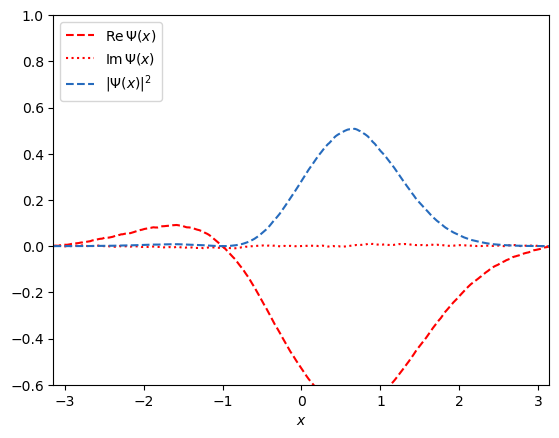

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# We use Hartree atomic units \hbar = m = 1

# Define the potential for the harmonic oscillator
def V(x):
    w = 1.0                       # to be changed later
    return 0.5 * w**2 * x**2 

# Define the domain
x_domain = [-np.pi, np.pi]  # spatial domain
t_domain = [0, 2*np.pi]     # temporal domain

N = 512                                   # Number of grid points
dx = (x_domain[1] - x_domain[0]) / (N-1)  # Define spatial step size
dt = (t_domain[1] - t_domain[0]) / (N-1)  # Define temporal step size

x = np.linspace(x_domain[0], x_domain[1], N)  # Define grid points
t = np.linspace(t_domain[0], t_domain[1], N)  # Define grid points

# Create Hamiltonian matrix and calculate its eigenvectors and eigenvalues
T = -0.5 * (np.diag(np.ones(N-1), k=-1) - 2*np.diag(np.ones(N), k=0) + np.diag(np.ones(N-1), k=1)) / (dx**2)
H = (T + np.diag(V(x))) * dt

Lambda, Q = np.linalg.eigh(H)  # Eigenvalues and eigenvectors of H
Q_inv = Q.conj().T  # Inverse of eigenvector Q (i.e., Q^-1 = Q^+)

# Initial condition
def u_0(x):
    w = 1.0
    return (w/np.pi)**0.25 * np.exp(-w*x**2/2.0)

def u_1(x):
    w=1
    return (w/np.pi)**0.25 * np.exp(-w*x**2/2.0) * x*np.sqrt(w)

Psi = (1.0/np.sqrt(2.0)) * (u_0(x) + u_1(x))
Psi = Psi.astype(np.complex128)

Psi_prob = []
Psi_prob.append(Psi.real**2 + Psi.imag**2)

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(-0.6, 1.0)
ax.set_xlabel(r'$x$')

# Plot elements
line_real, = ax.plot([], [], "--r", label=r'$\mathrm{Re}\, \Psi(x)$')
line_imag, = ax.plot([], [], ":r", label=r'$\mathrm{Im}\, \Psi(x)$')
line_prob, = ax.plot([], [], "--", color="#266bbd", label=r'$|\Psi(x)|^2$')
ax.legend(loc='upper left')

# Initialization function
def init():
    line_real.set_data([], [])
    line_imag.set_data([], [])
    line_prob.set_data([], [])
    return line_real, line_imag, line_prob

# Update function
def update(frame):
    global Psi
    Psi = np.dot(Q_inv, Psi)  # Expand into eigenfunctions/vectors
    Psi *= np.exp(-1j * Lambda)  # Propagate eigenfunctions/vectors
    Psi = np.dot(Q, Psi)  # Superpose eigenfunctions/vectors

    line_real.set_data(x, Psi.real)
    line_imag.set_data(x, Psi.imag)
    Psi_record = Psi.real**2 + Psi.imag**2
    line_prob.set_data(x, Psi_record)
    Psi_prob.append(Psi_record)

    return line_real, line_imag, line_prob

# Create animation
ani = animation.FuncAnimation(fig, update, frames=N-1, init_func=init, blit=True)

# Show the animation
# plt.show()
HTML(ani.to_jshtml())

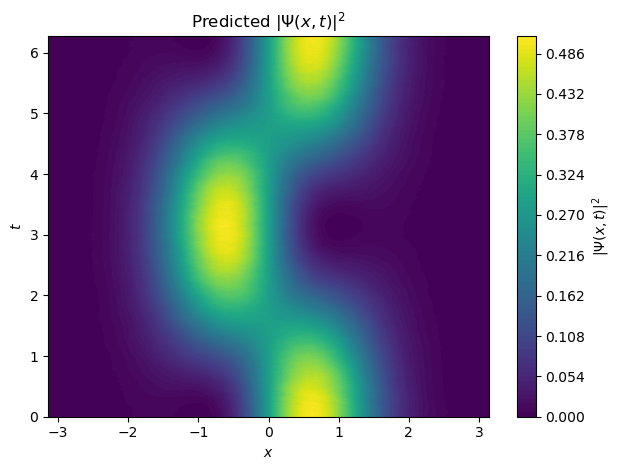

In [16]:
# Convert Psi_prob to a NumPy array
Psi_prob = np.array(Psi_prob)

# Create a contour plot
X, T_grid = np.meshgrid(x, t[:Psi_prob.shape[0]])  # t and x grid
# plt.figure(figsize=(8, 5))
contour = plt.contourf(X, T_grid, Psi_prob, levels=100, cmap="viridis")
plt.colorbar(contour, label=r'$|\Psi(x,t)|^2$')
plt.xlabel(r'$x$')
plt.ylabel(r'$t$')
plt.title(r'Predicted $|\Psi(x,t)|^2$')
plt.tight_layout()
plt.show()

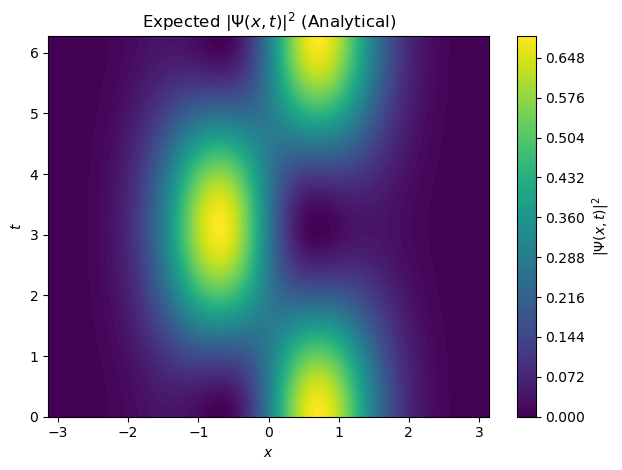

In [4]:
import numpy as np
import matplotlib.pyplot as plt

x_domain = [-np.pi, np.pi]
t_domain = [0.0, 2.0*np.pi]
N = 512

x = np.linspace(x_domain[0], x_domain[1], N)
t = np.linspace(t_domain[0], t_domain[1], N)

# Create meshgrid for (x, t)
X, T = np.meshgrid(x, t)

# analytical result (defined over meshgrid)
def U_0(x, t):
    w = 1.0
    return np.exp(-1j * 0.5 * w * t) * (w/np.pi)**0.25 * np.exp(-w * x**2 / 2.0)

def U_1(x, t):
    w = 1.0
    return np.exp(-1j * 1.5 * w * t) * (w/np.pi)**0.25 * np.exp(-w * x**2 / 2.0) * x * np.sqrt(2.0*w)

# Compute analytical solution
Psi_theo = (1.0 / np.sqrt(2.0)) * (U_0(X, T) + U_1(X, T))
Psi_theo_prob = np.abs(Psi_theo)**2  # Probability density

# Plot contour
# plt.figure(figsize=(8, 5))
contour = plt.contourf(X, T, Psi_theo_prob, levels=100, cmap="viridis")
plt.colorbar(contour, label=r'$|\Psi(x,t)|^2$')
plt.xlabel(r'$x$')
plt.ylabel(r'$t$')
plt.title(r'Expected $|\Psi(x,t)|^2$ (Analytical)')
plt.tight_layout()
plt.show()

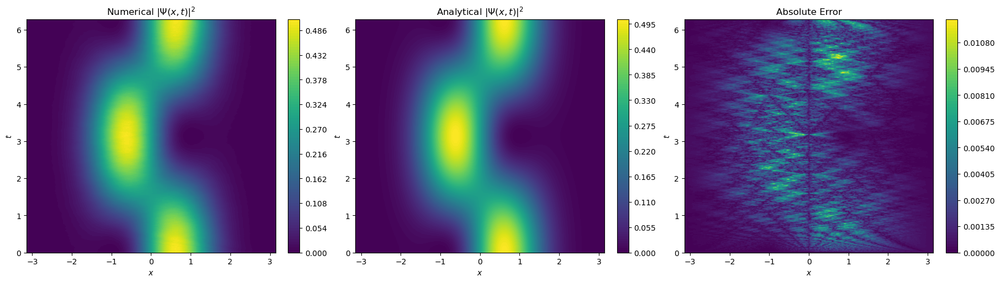

In [22]:
# Make sure Psi_prob is a NumPy array
Psi_prob = np.array(Psi_prob)  # shape: (frames, N)
Psi_prob = Psi_prob[:N, :]     # trim to match (N, N)

# Prepare meshgrid for plotting
X, T = np.meshgrid(x, t)

# Compute theoretical |Psi(x,t)|^2 as before
def U_0(x, t):
    w = 1.0
    return np.exp(-1j * 0.5 * w * t) * (w/np.pi)**0.25 * np.exp(-w * x**2 / 2.0)

def U_1(x, t):
    w = 1.0
    return np.exp(-1j * 1.5 * w * t) * (w/np.pi)**0.25 * np.exp(-w * x**2 / 2.0) * x * np.sqrt(w)

Psi_theo = (1.0 / np.sqrt(2.0)) * (U_0(X, T) + U_1(X, T))
Psi_theo_prob = np.abs(Psi_theo)**2

# Compute error
error = np.abs(Psi_prob - Psi_theo_prob)

# Plot: Side-by-side comparison
fig, axes = plt.subplots(1, 3, figsize=(18, 5), constrained_layout=True)

# Numerical
c1 = axes[0].contourf(X, T, Psi_prob, levels=100, cmap="viridis")
fig.colorbar(c1, ax=axes[0])
axes[0].set_title("Numerical $|\Psi(x,t)|^2$")
axes[0].set_xlabel("$x$")
axes[0].set_ylabel("$t$")

# Theoretical
c2 = axes[1].contourf(X, T, Psi_theo_prob, levels=100, cmap="viridis")
fig.colorbar(c2, ax=axes[1])
axes[1].set_title("Analytical $|\Psi(x,t)|^2$")
axes[1].set_xlabel("$x$")
axes[1].set_ylabel("$t$")

# Error
c3 = axes[2].contourf(X, T, error, levels=100, cmap="viridis")
fig.colorbar(c3, ax=axes[2])
axes[2].set_title("Absolute Error")
axes[2].set_xlabel("$x$")
axes[2].set_ylabel("$t$")

plt.show()

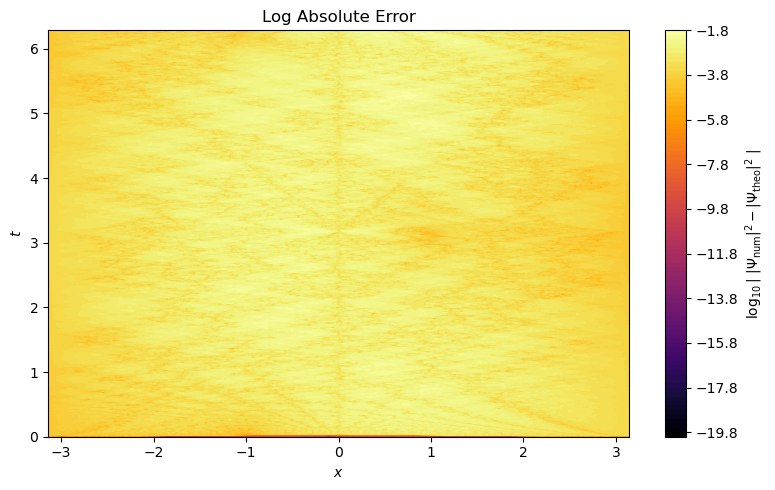

In [23]:
# Small epsilon to avoid log(0)
epsilon = 1e-20

# Compute log absolute error
log_abs_error = np.log10(np.abs(Psi_prob - Psi_theo_prob) + epsilon)

# Plot the log absolute error
plt.figure(figsize=(8, 5))
contour = plt.contourf(X, T, log_abs_error, levels=100, cmap="inferno")
plt.colorbar(contour, label=r'$\log_{10}|\ |\Psi_{\mathrm{num}}|^2 - |\Psi_{\mathrm{theo}}|^2\ |$')
plt.xlabel(r'$x$')
plt.ylabel(r'$t$')
plt.title("Log Absolute Error")
plt.tight_layout()
plt.show()
